In [1]:
import pandas as pd
import datetime
import math
import numpy as np
import hashlib
import scipy
import matplotlib.pyplot as plt
import matplotlib.mlab as mlab
import matplotlib.cm as cm

%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

import seaborn as sns
sns.set(style="ticks", color_codes=True, font_scale=1.5)
color = sns.color_palette()
sns.set_style('darkgrid')

from mpl_toolkits.mplot3d import Axes3D

import plotly as py
import plotly.graph_objs as go
py.offline.init_notebook_mode()

from scipy import stats
from scipy.stats import skew, norm, probplot, boxcox
from sklearn import preprocessing
import math

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

In [2]:
order = pd.read_csv('olist_orders_dataset.csv')
cust = pd.read_csv('olist_customers_dataset.csv')
payment = pd.read_csv('olist_order_payments_dataset.csv')
order_items = pd.read_csv('olist_order_items_dataset.csv')

In [3]:
print(f"olist_orders_dataset: {order.columns}")
print(f"olist_customers_dataset: {cust.columns}")
print(f"olist_order_payments_dataset: {payment.columns}")
print(f"olist_order_items_dataset: {order_items.columns}")

olist_orders_dataset: Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date'],
      dtype='object')
olist_customers_dataset: Index(['customer_id', 'customer_unique_id', 'customer_zip_code_prefix',
       'customer_city', 'customer_state'],
      dtype='object')
olist_order_payments_dataset: Index(['order_id', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value'],
      dtype='object')
olist_order_items_dataset: Index(['order_id', 'order_item_id', 'product_id', 'seller_id',
       'shipping_limit_date', 'price', 'freight_value'],
      dtype='object')


In [4]:
# creating master dataframe 
payment.head()
df1 = payment.merge(order_items, on='order_id')
df2 = df1.merge(order, on='order_id')
df = df2.merge(cust, on='customer_id')
print(df.shape)

(117601, 22)


In [5]:
df.head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33,1,af74cc53dcffc8384b29e7abfa41902b,213b25e6f54661939f11710a6fddb871,2018-05-02 22:15:09,79.80,...,delivered,2018-04-25 22:01:49,2018-04-25 22:15:09,2018-05-02 15:20:00,2018-05-09 17:36:51,2018-05-22 00:00:00,708ab75d2a007f0564aedd11139c7708,39801,teofilo otoni,MG
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39,1,a630cc320a8c872f9de830cf121661a3,eaf6d55068dea77334e8477d3878d89e,2018-07-02 11:18:58,17.00,...,delivered,2018-06-26 11:01:38,2018-06-26 11:18:58,2018-06-28 14:18:00,2018-06-29 20:32:09,2018-07-16 00:00:00,a8b9d3a27068454b1c98cc67d4e31e6f,2422,sao paulo,SP
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71,1,2028bf1b01cafb2d2b1901fca4083222,cc419e0650a3c5ba77189a1882b7556a,2017-12-26 09:52:34,56.99,...,delivered,2017-12-12 11:19:55,2017-12-14 09:52:34,2017-12-15 20:13:22,2017-12-18 17:24:41,2018-01-04 00:00:00,6f70c0b2f7552832ba46eb57b1c5651e,2652,sao paulo,SP
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78,1,548e5bfe28edceab6b51fa707cc9556f,da8622b14eb17ae2831f4ac5b9dab84a,2017-12-12 12:13:20,89.90,...,delivered,2017-12-06 12:04:06,2017-12-06 12:13:20,2017-12-07 20:28:28,2017-12-21 01:35:51,2018-01-04 00:00:00,87695ed086ebd36f20404c82d20fca87,36060,juiz de fora,MG
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45,1,386486367c1f9d4f587a8864ccb6902b,cca3071e3e9bb7d12640c9fbe2301306,2018-05-31 16:14:41,113.57,...,delivered,2018-05-21 13:59:17,2018-05-21 16:14:41,2018-05-22 11:46:00,2018-06-01 21:44:53,2018-06-13 00:00:00,4291db0da71914754618cd789aebcd56,18570,conchas,SP


In [6]:
df.isnull().sum()

order_id                            0
payment_sequential                  0
payment_type                        0
payment_installments                0
payment_value                       0
order_item_id                       0
product_id                          0
seller_id                           0
shipping_limit_date                 0
price                               0
freight_value                       0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                  15
order_delivered_carrier_date     1245
order_delivered_customer_date    2567
order_estimated_delivery_date       0
customer_unique_id                  0
customer_zip_code_prefix            0
customer_city                       0
customer_state                      0
dtype: int64

In [7]:
# converting date columns to datetime
date_columns = ['shipping_limit_date', 'order_purchase_timestamp', 'order_approved_at', 'order_delivered_carrier_date', 'order_delivered_customer_date', 'order_estimated_delivery_date']
for col in date_columns:
    df[col] = pd.to_datetime(df[col], format='%Y-%m-%d %H:%M:%S')
    
# cleaning up name columns
df['customer_city'] = df['customer_city'].str.title()
df['payment_type'] = df['payment_type'].str.replace('_', ' ').str.title()
# engineering new/essential columns
df['delivery_against_estimated'] = (df['order_estimated_delivery_date'] - df['order_delivered_customer_date']).dt.days
df['order_purchase_year'] = df.order_purchase_timestamp.apply(lambda x: x.year)
df['order_purchase_month'] = df.order_purchase_timestamp.apply(lambda x: x.month)
df['order_purchase_dayofweek'] = df.order_purchase_timestamp.apply(lambda x: x.dayofweek)
df['order_purchase_hour'] = df.order_purchase_timestamp.apply(lambda x: x.hour)
df['order_purchase_day'] = df['order_purchase_dayofweek'].map({0:'Mon',1:'Tue',2:'Wed',3:'Thu',4:'Fri',5:'Sat',6:'Sun'})
df['order_purchase_mon'] = df.order_purchase_timestamp.apply(lambda x: x.month).map({1:'Jan',2:'Feb',3:'Mar',4:'Apr',5:'May',6:'Jun',7:'Jul',8:'Aug',9:'Sep',10:'Oct',11:'Nov',12:'Dec'})
# Changing the month attribute for correct ordenation
df['month_year'] = df['order_purchase_month'].astype(str).apply(lambda x: '0' + x if len(x) == 1 else x)
df['month_year'] = df['order_purchase_year'].astype(str) + '-' + df['month_year'].astype(str)
#creating year month column
df['month_y'] = df['order_purchase_timestamp'].map(lambda date: 100*date.year + date.month)

In [8]:
# displaying summary staticstics of columns
df.describe(include='all')

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,customer_state,delivery_against_estimated,order_purchase_year,order_purchase_month,order_purchase_dayofweek,order_purchase_hour,order_purchase_day,order_purchase_mon,month_year,month_y
count,117601,117601.000000,117601,117601.000000,117601.000000,117601.000000,117601,117601,117601,117601.000000,...,117601,115034.000000,117601.000000,117601.000000,117601.000000,117601.000000,117601,117601,117601,117601.000000
unique,98665,NaN,4,NaN,NaN,NaN,32951,3095,93317,NaN,...,27,NaN,NaN,NaN,NaN,NaN,7,12,24,NaN
top,895ab968e7bb0d5659d16cd74cd1650c,NaN,Credit Card,NaN,NaN,NaN,aca2eb7d00ea1a7b8ebd4e68314663af,4a3ca9315b744ce9f8e9374361493884,2017-08-14 20:43:31,NaN,...,SP,NaN,NaN,NaN,NaN,NaN,Mon,Aug,2017-11,NaN
freq,63,NaN,86769,NaN,NaN,NaN,536,2133,63,NaN,...,49566,NaN,NaN,NaN,NaN,NaN,19130,12632,9016,NaN
first,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2016-09-19 00:15:34,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2020-04-09 22:35:08,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,1.093528,NaN,2.939482,172.686752,1.195900,NaN,NaN,NaN,120.824783,...,NaN,11.043326,2017.538193,6.028129,2.745750,14.760002,NaN,NaN,NaN,201759.847399
std,NaN,0.726692,NaN,2.774223,267.592290,0.697706,NaN,NaN,NaN,184.479323,...,NaN,10.162307,0.505065,3.229579,1.961257,5.325670,NaN,NaN,NaN,48.798820
min,NaN,1.000000,NaN,0.000000,0.000000,1.000000,NaN,NaN,NaN,0.850000,...,NaN,-189.000000,2016.000000,1.000000,0.000000,0.000000,NaN,NaN,NaN,201609.000000
25%,NaN,1.000000,NaN,1.000000,60.870000,1.000000,NaN,NaN,NaN,39.900000,...,NaN,6.000000,2017.000000,3.000000,1.000000,11.000000,NaN,NaN,NaN,201709.000000


In [9]:
# displaying missing value counts and corresponding percentage against total observations
missing_values = df.isnull().sum().sort_values(ascending = False)
percentage = (df.isnull().sum()/df.isnull().count()*100).sort_values(ascending = False)
pd.concat([missing_values, percentage], axis=1, keys=['Values', 'Percentage']).transpose()

,order_delivered_customer_date,delivery_against_estimated,order_delivered_carrier_date,order_approved_at,month_year,order_purchase_mon,order_purchase_day,order_purchase_hour,order_purchase_dayofweek,order_purchase_month,...,freight_value,price,shipping_limit_date,seller_id,product_id,order_item_id,payment_value,payment_installments,payment_type,month_y
Values,2567.000000,2567.000000,1245.000000,15.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Percentage,2.182805,2.182805,1.058664,0.012755,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [10]:
# dropping missing values
df.dropna(inplace=True)
df.isnull().values.any()

False

In [11]:
# displaying dataframe info
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 115018 entries, 0 to 117600
Data columns (total 31 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   order_id                       115018 non-null  object        
 1   payment_sequential             115018 non-null  int64         
 2   payment_type                   115018 non-null  object        
 3   payment_installments           115018 non-null  int64         
 4   payment_value                  115018 non-null  float64       
 5   order_item_id                  115018 non-null  int64         
 6   product_id                     115018 non-null  object        
 7   seller_id                      115018 non-null  object        
 8   shipping_limit_date            115018 non-null  datetime64[ns]
 9   price                          115018 non-null  float64       
 10  freight_value                  115018 non-null  float64       
 11  

In [12]:
df['month_year'].min()

'2016-10'

In [13]:
df['month_year'].max()

'2018-08'

In [14]:
#calculate Revenue for each row and create a new dataframe with YearMonth - Revenue columns
df_revenue = df.groupby(['month_year'])['payment_value'].sum().reset_index()
df_revenue

,month_year,payment_value
0,2016-10,62591.65
1,2016-12,19.62
2,2017-01,176376.56
3,2017-02,323815.95
4,2017-03,505735.83
5,2017-04,456108.32
6,2017-05,701119.60
7,2017-06,585400.98
8,2017-07,716069.98
9,2017-08,842689.94


In [15]:
#calculating for monthly revenie growth rate
# using pct_change() function to see monthly percentage change
df_revenue['MonthlyGrowth'] = df_revenue['payment_value'].pct_change()

df_revenue

,month_year,payment_value,MonthlyGrowth
0,2016-10,62591.65,NaN
1,2016-12,19.62,-0.999687
2,2017-01,176376.56,8988.630989
3,2017-02,323815.95,0.835935
4,2017-03,505735.83,0.561800
5,2017-04,456108.32,-0.098129
6,2017-05,701119.60,0.537178
7,2017-06,585400.98,-0.165048
8,2017-07,716069.98,0.223213
9,2017-08,842689.94,0.176826


In [18]:
import datetime
#creates a generic user dataframe to keep CustomerID and new segmentation scores
df_user = pd.DataFrame(df['customer_unique_id'])
df_user.columns = ['customer_unique_id']

#gets the max purchase date for each customer and create a dataframe with it
df_max_purchase = df.groupby('customer_unique_id').order_purchase_timestamp.max().reset_index() 
df_max_purchase.columns = ['customer_unique_id', 'MaxPurchaseDate']


#we take our observation point as the max purchase date in our dataset
df_max_purchase['Recency'] = (df_max_purchase['MaxPurchaseDate'].max() - df_max_purchase['MaxPurchaseDate']).dt.days

#merge this dataframe to our new user dataframe
df_user = pd.merge(df_user, df_max_purchase[['customer_unique_id','Recency']], on='customer_unique_id')

df_user.head()

,customer_unique_id,Recency
0,708ab75d2a007f0564aedd11139c7708,125
1,a8b9d3a27068454b1c98cc67d4e31e6f,64
2,6f70c0b2f7552832ba46eb57b1c5651e,260
3,87695ed086ebd36f20404c82d20fca87,266
4,4291db0da71914754618cd789aebcd56,28


In [19]:
# getting summary statistics of the recency table
df_user.Recency.describe()

count    115018.000000
mean        237.228564
std         152.514177
min           0.000000
25%         113.000000
50%         218.000000
75%         345.000000
max         694.000000
Name: Recency, dtype: float64

In [20]:
def QQ_plot(data, measure):
    fig = plt.figure(figsize=(20,7))

    #Get the fitted parameters used by the function
    (mu, sigma) = norm.fit(data)

    #Kernel Density plot
    fig1 = fig.add_subplot(121)
    sns.distplot(data, fit=norm)
    fig1.set_title(measure + ' Distribution ( mu = {:.2f} and sigma = {:.2f} )'.format(mu, sigma), loc='center')
    fig1.set_xlabel(measure)
    fig1.set_ylabel('Frequency')

    #QQ plot
    fig2 = fig.add_subplot(122)
    res = probplot(data, plot=fig2)
    fig2.set_title(measure + ' Probability Plot (skewness: {:.6f} and kurtosis: {:.6f} )'.format(data.skew(), data.kurt()), loc='center')

    plt.tight_layout()
    plt.show()

In [21]:
#get order counts for each user and create a dataframe with it
df_frequency = df.groupby('customer_unique_id').order_purchase_timestamp.count().reset_index()
df_frequency.columns = ['customer_unique_id','Frequency']

#add this data to our main dataframe
df_user = pd.merge(df_user, df_frequency, on='customer_unique_id')

df_user.head()

,customer_unique_id,Recency,Frequency
0,708ab75d2a007f0564aedd11139c7708,125,1
1,a8b9d3a27068454b1c98cc67d4e31e6f,64,1
2,6f70c0b2f7552832ba46eb57b1c5651e,260,1
3,87695ed086ebd36f20404c82d20fca87,266,1
4,4291db0da71914754618cd789aebcd56,28,3


In [22]:
# getting summary statistics of the recency table
df_user.Frequency.describe()

count    115018.000000
mean          1.777670
std           2.771438
min           1.000000
25%           1.000000
50%           1.000000
75%           2.000000
max          75.000000
Name: Frequency, dtype: float64

In [23]:
#calculate revenue for each customer
df_revenue = df.groupby('customer_unique_id').payment_value.sum().reset_index()

#merge it with our main dataframe
df_user = pd.merge(df_user, df_revenue, on='customer_unique_id')

df_user.head()

,customer_unique_id,Recency,Frequency,payment_value
0,708ab75d2a007f0564aedd11139c7708,125,1,99.33
1,a8b9d3a27068454b1c98cc67d4e31e6f,64,1,24.39
2,6f70c0b2f7552832ba46eb57b1c5651e,260,1,65.71
3,87695ed086ebd36f20404c82d20fca87,266,1,107.78
4,4291db0da71914754618cd789aebcd56,28,3,627.74


In [24]:
df_user.rename(columns={'payment_value': 'Monetary'}, inplace=True, errors='raise')
df_user.head()

,customer_unique_id,Recency,Frequency,Monetary
0,708ab75d2a007f0564aedd11139c7708,125,1,99.33
1,a8b9d3a27068454b1c98cc67d4e31e6f,64,1,24.39
2,6f70c0b2f7552832ba46eb57b1c5651e,260,1,65.71
3,87695ed086ebd36f20404c82d20fca87,266,1,107.78
4,4291db0da71914754618cd789aebcd56,28,3,627.74


In [25]:
# getting summary statistics of the recency table
df_user.Monetary.describe()

count    115018.000000
mean        375.328291
std        1665.299621
min           9.590000
25%          70.040000
50%         133.530000
75%         276.960000
max      109312.640000
Name: Monetary, dtype: float64

### Plotting the distribution and Kernel Density Plot for R, F and M values

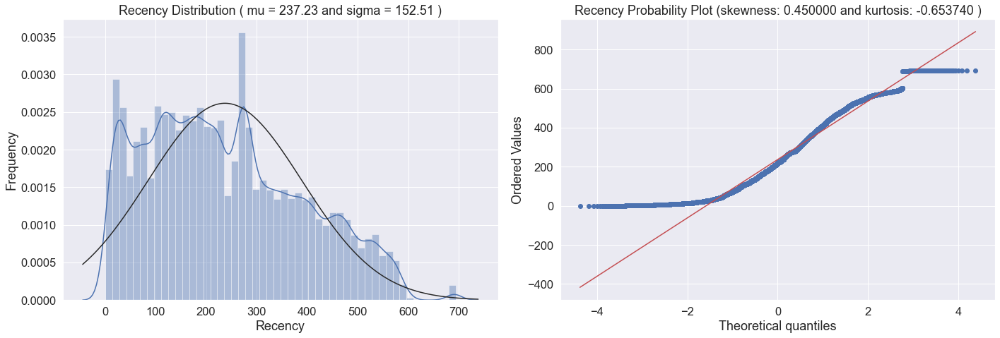

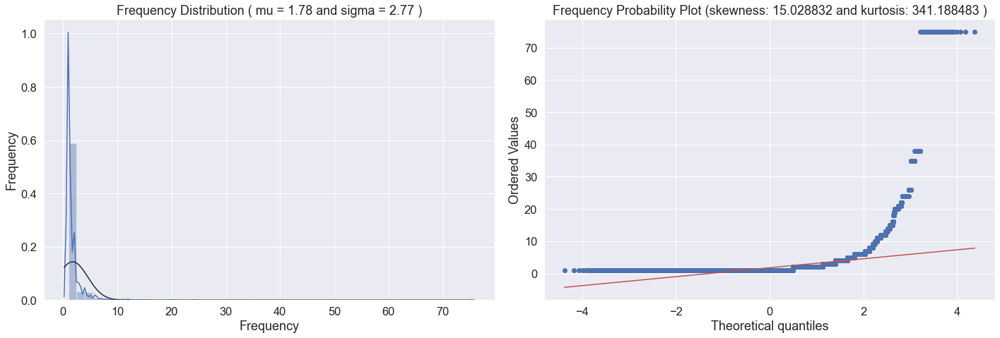

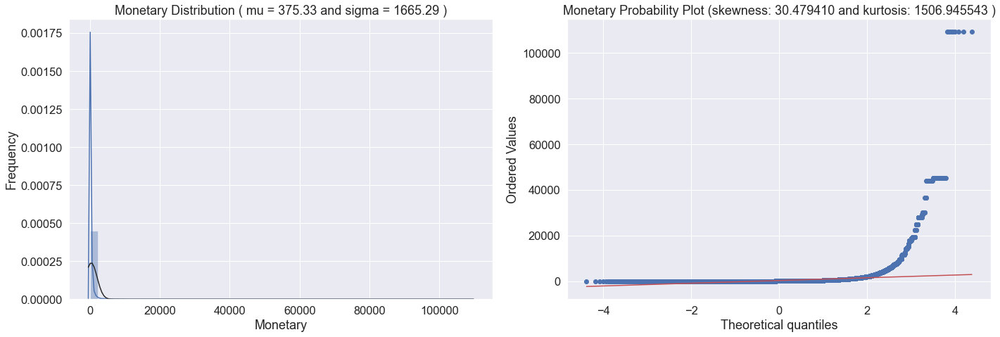

In [26]:
QQ_plot(df_user.Recency, 'Recency')
QQ_plot(df_user.Frequency, 'Frequency')
QQ_plot(df_user.Monetary, 'Monetary')

<b>The skewness for a normal distribution is zero, and any symmetric data should have a skewness near zero. Negative values for the skewness indicate data that are skewed left and positive values for the skewness indicate data that are skewed right. By skewed left, we mean that the left tail is long relative to the right tail. Similarly, skewed right means that the right tail is long relative to the left tail.</b>

positive skewness is not desirable for distribution, as a high level of skewness can cause misleading results. The data transformation tools are helping to make the skewed data closer to a normal distribution. For positively skewed distributions, the famous transformation is the log transformation. The log transformation proposes the calculations of the natural logarithm for each value in the dataset.

### Log Transformation on skewed data

In [27]:
rfm_log = df_user.copy()
for i in rfm_log.columns[1:]:
    rfm_log[i] = np.log(rfm_log[i])
    
rfm_log

,customer_unique_id,Recency,Frequency,Monetary
0,708ab75d2a007f0564aedd11139c7708,4.828314,0.000000,4.598448
1,a8b9d3a27068454b1c98cc67d4e31e6f,4.158883,0.000000,3.194173
2,6f70c0b2f7552832ba46eb57b1c5651e,5.560682,0.000000,4.185251
3,87695ed086ebd36f20404c82d20fca87,5.583496,0.000000,4.680092
4,4291db0da71914754618cd789aebcd56,3.332205,1.098612,6.442126
...,...,...,...,...
115013,18f40b803060d9883643b7e64e91628e,5.164786,0.000000,5.268425
115014,13f283df2f4760f22b57830865761d07,4.653960,0.000000,5.293003
115015,b6027ac07fb76ebca8c97b1887865aee,5.153292,0.000000,5.895256
115016,b84dc68f02f122a88d7e7bbd37b06204,3.044522,0.000000,5.912259


### Checking distribution after log transformation

In [28]:
rfm_log.shape

(115018, 4)

In [29]:
rfm_log.replace([np.inf, -np.inf], np.nan, inplace=True)
# rfm_log[rfm_log==np.inf]=np.nan
rfm_log.dropna(inplace=True)

In [32]:
rfm_log = rfm_log.reset_index()
rfm_log

,index,customer_unique_id,Recency,Frequency,Monetary
0,0,708ab75d2a007f0564aedd11139c7708,4.828314,0.000000,4.598448
1,1,a8b9d3a27068454b1c98cc67d4e31e6f,4.158883,0.000000,3.194173
2,2,6f70c0b2f7552832ba46eb57b1c5651e,5.560682,0.000000,4.185251
3,3,87695ed086ebd36f20404c82d20fca87,5.583496,0.000000,4.680092
4,4,4291db0da71914754618cd789aebcd56,3.332205,1.098612,6.442126
...,...,...,...,...,...
114970,115013,18f40b803060d9883643b7e64e91628e,5.164786,0.000000,5.268425
114971,115014,13f283df2f4760f22b57830865761d07,4.653960,0.000000,5.293003
114972,115015,b6027ac07fb76ebca8c97b1887865aee,5.153292,0.000000,5.895256
114973,115016,b84dc68f02f122a88d7e7bbd37b06204,3.044522,0.000000,5.912259


In [31]:
rfm_log.shape

(114975, 4)

### Scaling the log transformed values

In [33]:
feature_vector = ['Recency','Frequency','Monetary',]

X_subset = rfm_log[feature_vector] #.as_matrix()
X_subset.replace([np.inf, -np.inf], np.nan, inplace=True)

scaler = preprocessing.StandardScaler().fit(X_subset)

X_scaled = scaler.transform(X_subset)

X_scaled_df = pd.DataFrame(X_scaled, columns=X_subset.columns)
round(X_scaled_df.describe().T,2)

,count,mean,std,min,25%,50%,75%,max
Recency,114975.0,0.0,1.0,-5.36,-0.44,0.24,0.72,1.45
Frequency,114975.0,0.0,1.0,-0.57,-0.57,-0.57,0.66,7.09
Monetary,114975.0,0.0,1.0,-2.54,-0.72,-0.12,0.54,6.03


In [34]:
X_scaled_df

,Recency,Frequency,Monetary
0,-0.333986,-0.571299,-0.396089
1,-1.030698,-0.571299,-1.684829
2,0.428228,-0.571299,-0.775291
3,0.451973,-0.571299,-0.321162
4,-1.891066,1.378636,1.295904
...,...,...,...
114970,0.016199,-0.571299,0.218767
114971,-0.515444,-0.571299,0.241323
114972,0.004236,-0.571299,0.794027
114973,-2.190472,-0.571299,0.809631


### Distribution after scaling

In [35]:
X_scaled_df.replace([np.inf, -np.inf], np.nan, inplace=True)
X_scaled_df.dropna(inplace=True)

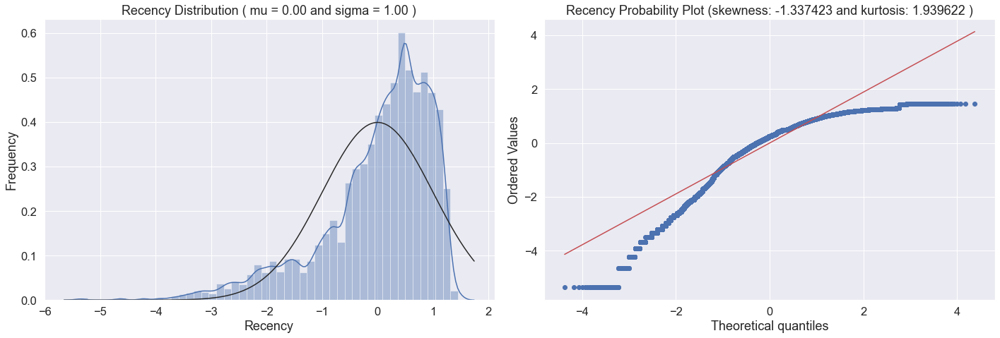

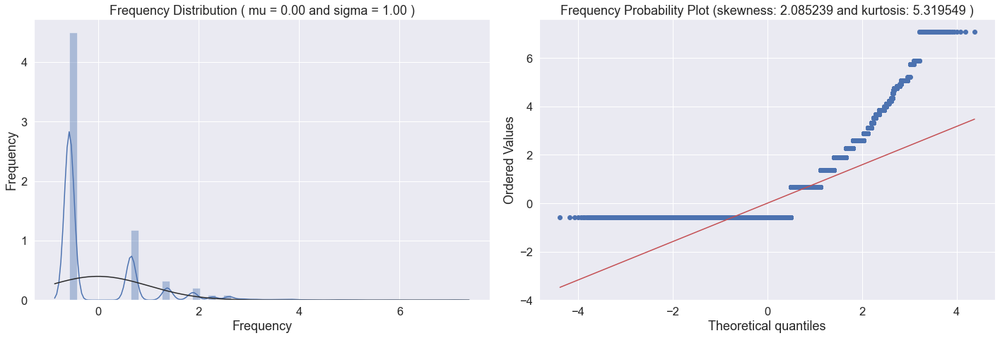

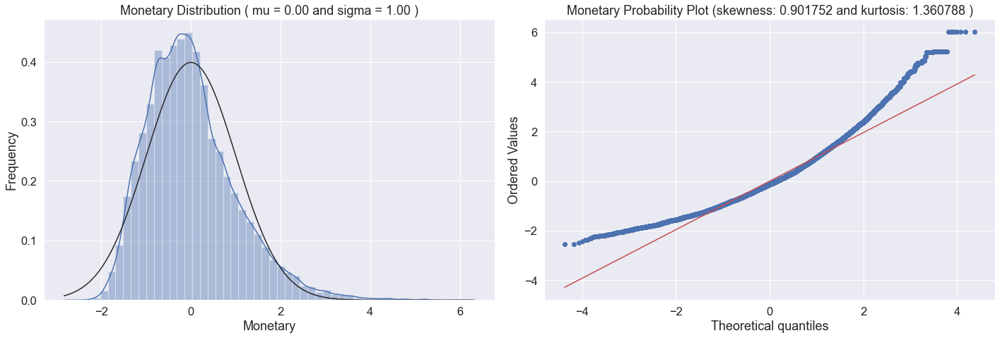

In [36]:
QQ_plot(X_scaled_df.Recency,'Recency')
QQ_plot(X_scaled_df.Frequency,'Frequency')
QQ_plot(X_scaled_df.Monetary,'Monetary')

In [37]:
X_scaled_df.head()

,Recency,Frequency,Monetary
0,-0.333986,-0.571299,-0.396089
1,-1.030698,-0.571299,-1.684829
2,0.428228,-0.571299,-0.775291
3,0.451973,-0.571299,-0.321162
4,-1.891066,1.378636,1.295904


<AxesSubplot:xlabel='Recency', ylabel='Monetary'>

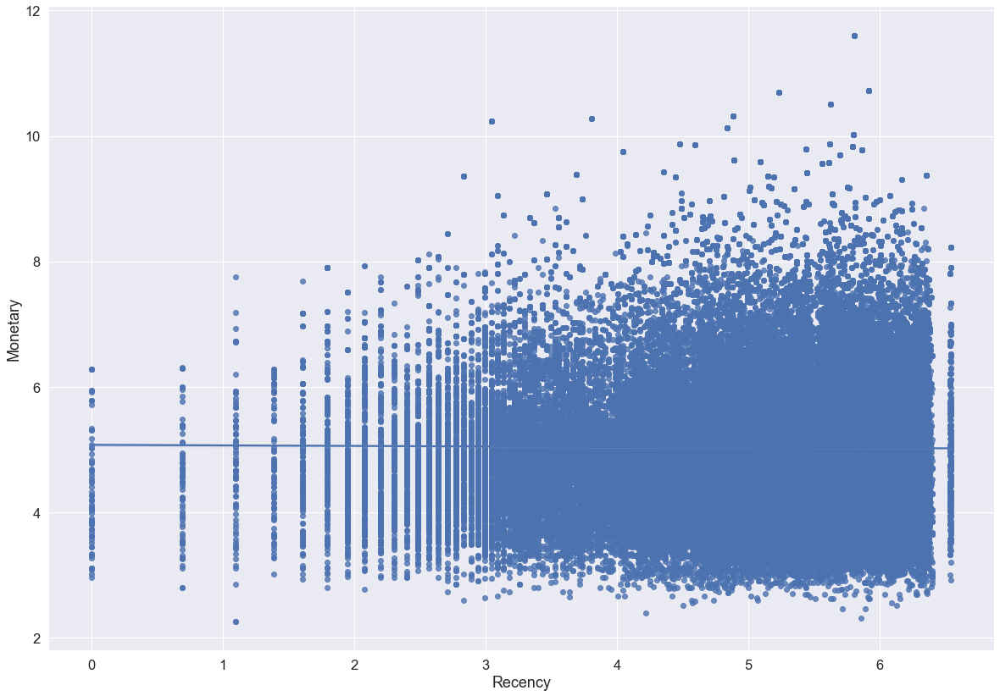

In [38]:
fig = plt.figure(figsize=(20,14))
sns.regplot(x='Recency', y='Monetary', data=rfm_log)

<AxesSubplot:xlabel='Frequency', ylabel='Monetary'>

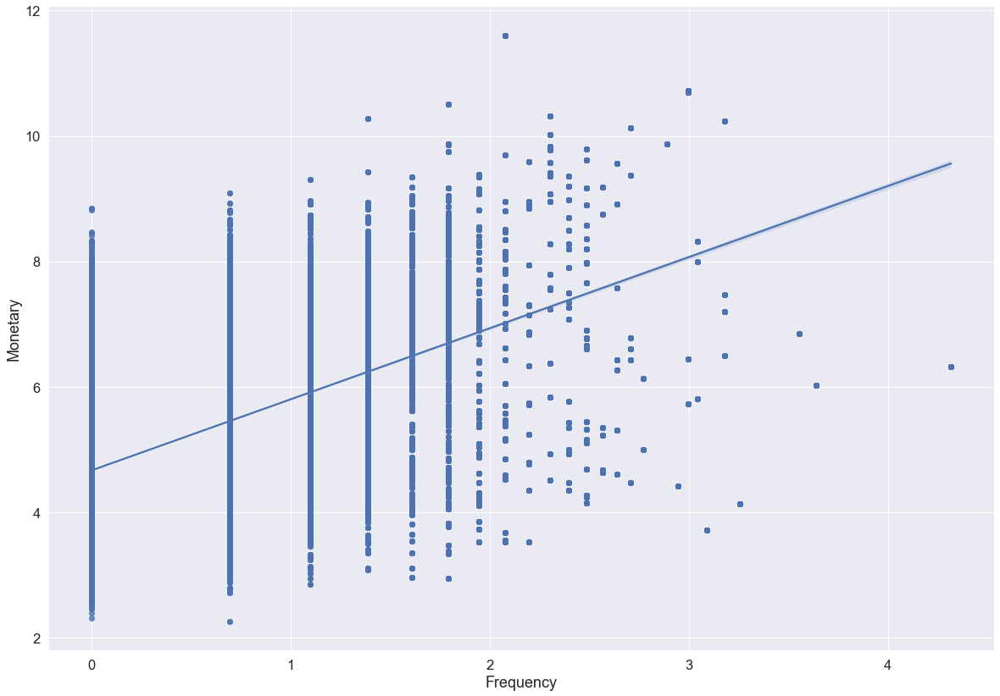

In [39]:
fig = plt.figure(figsize=(20,14))
sns.regplot(x='Frequency', y='Monetary', data=rfm_log)

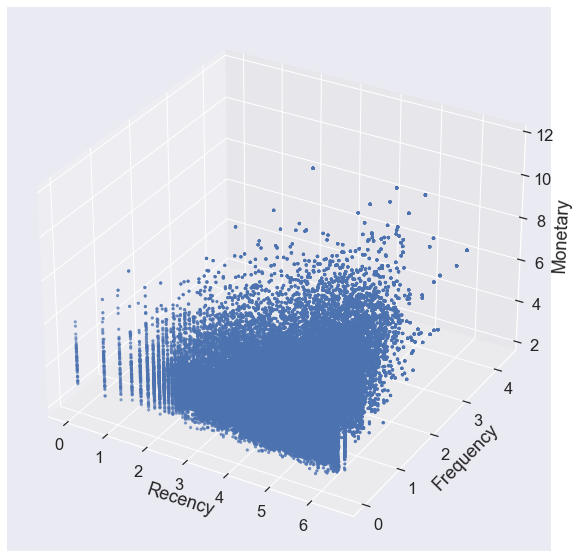

In [40]:
fig = plt.figure(figsize=(20, 10))
ax = fig.add_subplot(111, projection='3d')

xs =rfm_log.Recency
ys = rfm_log.Frequency
zs = rfm_log.Monetary
ax.scatter(xs, ys, zs, s=5)

ax.set_xlabel('Recency')
ax.set_ylabel('Frequency')
ax.set_zlabel('Monetary')

plt.show()

## Elbow method to find no of clusters

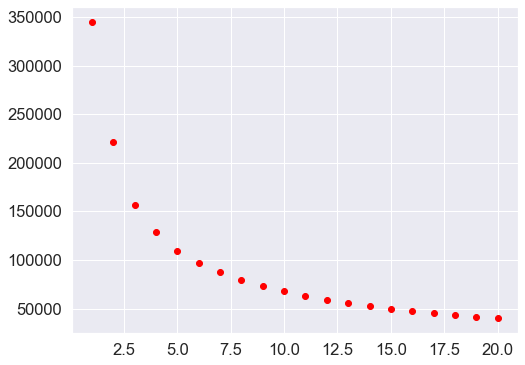

The best K sugest:  6


In [41]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score


cl = 20
corte = 0.1

anterior = 100000000000000
cost = [] 
K_best = cl

for k in range (1, cl+1):
    # Create a kmeans model on our data, using k clusters.  random_state helps ensure that the algorithm returns the same results each time.
    model = KMeans(
        n_clusters=k, 
        init='k-means++', #'random',
        n_init=10,
        max_iter=300,
        tol=1e-04,
        random_state=101)

    model = model.fit(X_scaled_df)

    # labels for clusters -- the first cluster has label 0, and the second has label 1.
    labels = model.labels_
 
    # Sum of distances of samples to their closest cluster center
    interia = model.inertia_
    
    if (K_best == cl) and (((anterior - interia)/anterior) < corte): K_best = k - 1
    cost.append(interia)
    anterior = interia

plt.figure(figsize=(8, 6))
plt.scatter(range (1, cl+1), cost, c='red')
plt.show()

# Create a kmeans model with the best K.
print('The best K sugest: ',K_best)
model = KMeans(n_clusters=K_best, init='k-means++', n_init=10,max_iter=300, tol=1e-04, random_state=101)

# scaling the data to normalize
model = model.fit(X_scaled_df)

# fitted labels for clusters -- the first cluster has label 0, and the second has label 1.
labels = model.labels_

In [ ]:
K_best = 6

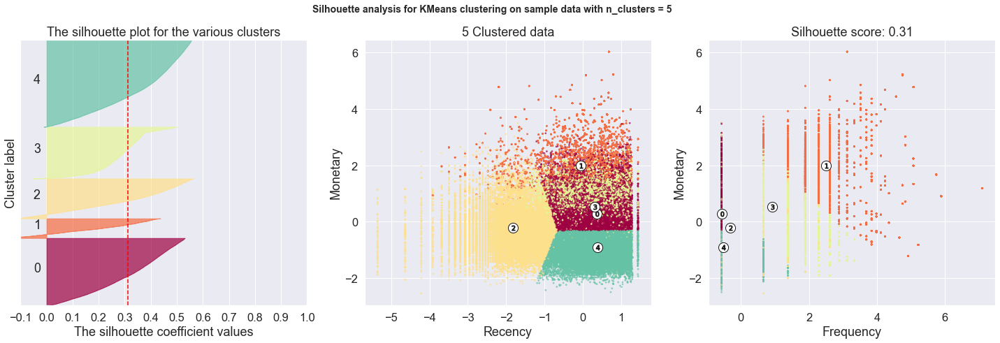

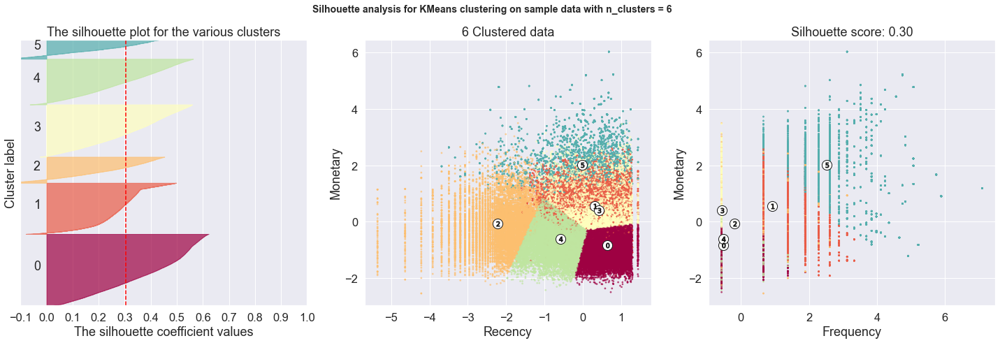

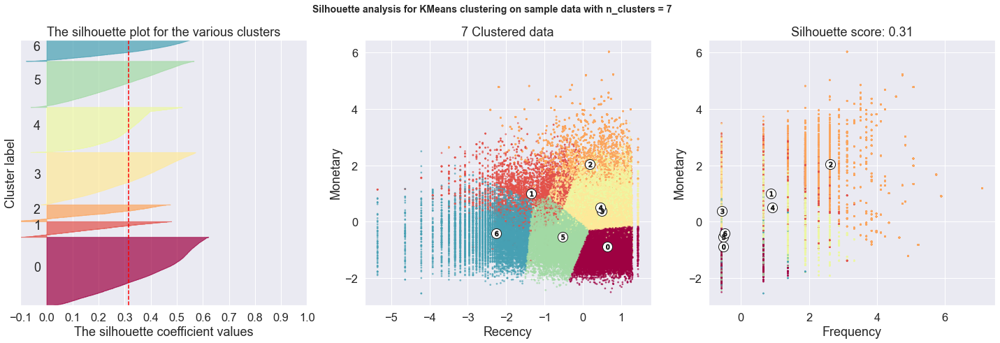

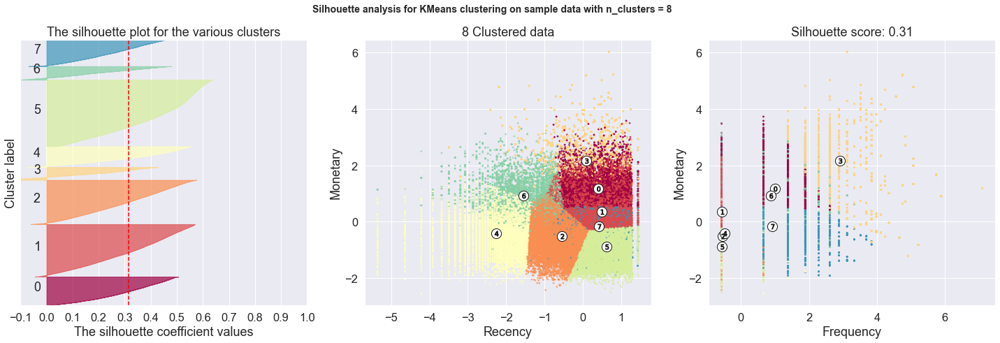

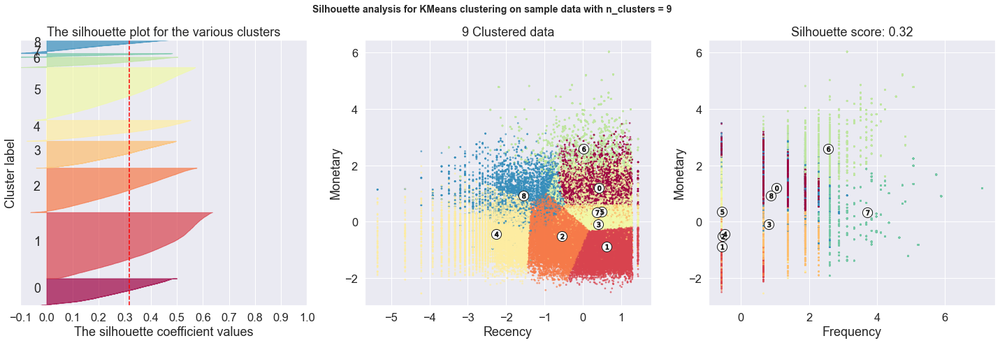

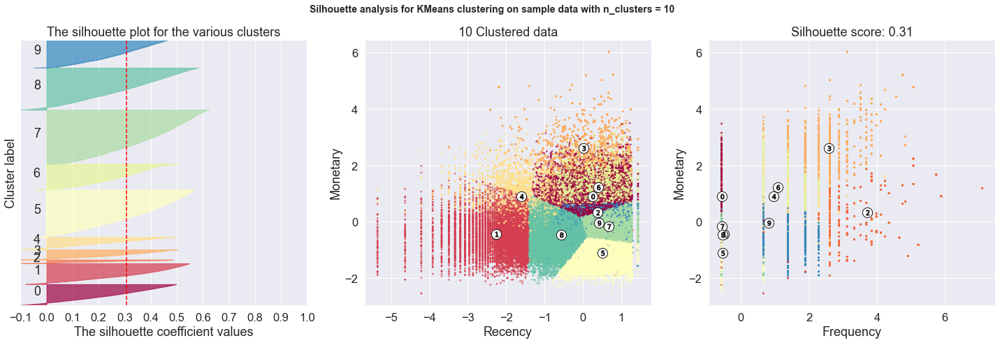

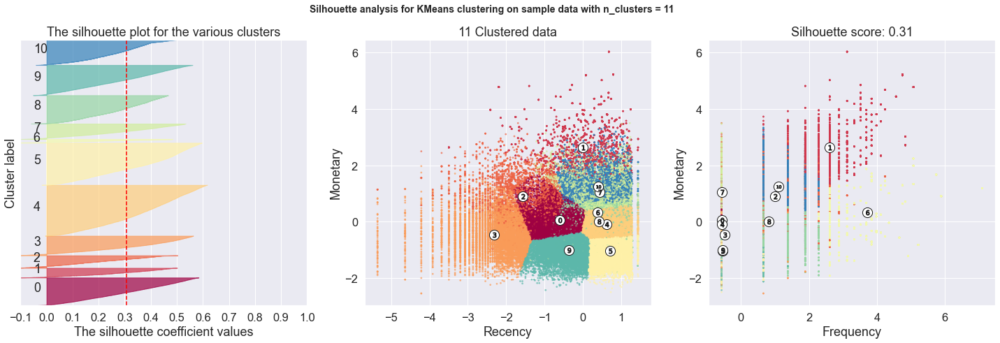

In [42]:
cluster_centers = dict()

for n_clusters in range(5,12,1):
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3)
    fig.set_size_inches(25, 7)
    ax1.set_xlim([-0.1, 1])
    ax1.set_ylim([0, len(X_scaled_df) + (n_clusters + 1) * 10])

    clusterer = KMeans(n_clusters=n_clusters, init='k-means++', n_init=10,max_iter=300, tol=1e-04, random_state=101)
    cluster_labels = clusterer.fit_predict(X_scaled_df)

    silhouette_avg = silhouette_score(X = X_scaled_df, labels = cluster_labels)
    cluster_centers.update({n_clusters :{'cluster_center':clusterer.cluster_centers_,
                                         'silhouette_score':silhouette_avg,
                                         'labels':cluster_labels}
                           })

    sample_silhouette_values = silhouette_samples(X = X_scaled_df, labels = cluster_labels)
    y_lower = 10
    for i in range(n_clusters):
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.Spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")
    ax1.set_yticks([])
    ax1.set_xticks([-0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1])
    colors = cm.Spectral(cluster_labels.astype(float) / n_clusters)
    
    centers = clusterer.cluster_centers_
    y = 2
    x = 0
    ax2.scatter(X_scaled_df.iloc[:, x], X_scaled_df.iloc[:, y], marker='.', s=30, lw=0, alpha=0.7, c=colors, edgecolor='k')   
    ax2.scatter(centers[:, x], centers[:, y], marker='o', c="white", alpha=1, s=200, edgecolor='k')
    for i, c in enumerate(centers):
        ax2.scatter(c[x], c[y], marker='$%d$' % i, alpha=1, s=50, edgecolor='k')
    ax2.set_title("{} Clustered data".format(n_clusters))
    ax2.set_xlabel(feature_vector[x]) # Recency
    ax2.set_ylabel(feature_vector[y]) # Monetary

    x = 1
    ax3.scatter(X_scaled_df.iloc[:, x], X_scaled_df.iloc[:, y], marker='.', s=30, lw=0, alpha=0.7, c=colors, edgecolor='k')   
    ax3.scatter(centers[:, x], centers[:, y], marker='o', c="white", alpha=1, s=200, edgecolor='k')
    for i, c in enumerate(centers):
        ax3.scatter(c[x], c[y], marker='$%d$' % i, alpha=1, s=50, edgecolor='k')
    ax3.set_title("Silhouette score: {:1.2f}".format(cluster_centers[n_clusters]['silhouette_score']))
    ax3.set_xlabel(feature_vector[x]) # Frequency
    ax3.set_ylabel(feature_vector[y]) # Monetary
    
    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')
    plt.show()

In [43]:
features = ['Recency', 'Frequency','Monetary']
for i in range(5,12,1):
    print("for {} clusters the silhouette score is {:1.2f}".format(i, cluster_centers[i]['silhouette_score']))
    print("Centers of each cluster:")
    cent_transformed = scaler.inverse_transform(cluster_centers[i]['cluster_center'])
    print(pd.DataFrame(np.exp(cent_transformed),columns=features))
    print('-'*50)

for 5 clusters the silhouette score is 0.31
Centers of each cluster:
      Recency  Frequency     Monetary
0  244.500296   1.000000   210.134668
1  163.138713   5.648129  1346.597271
2   29.888620   1.160938   120.350964
3  233.077609   2.305950   275.909289
4  248.362853   1.029027    57.579330
--------------------------------------------------
for 6 clusters the silhouette score is 0.30
Centers of each cluster:
      Recency  Frequency     Monetary
0  322.145915   1.031664    61.216666
1  232.499439   2.311265   282.089778
2   20.317900   1.240868   144.230223
3  260.326494   1.000000   241.484201
4   98.914871   1.033046    79.326853
5  168.770419   5.710351  1366.004453
--------------------------------------------------
for 7 clusters the silhouette score is 0.31
Centers of each cluster:
      Recency  Frequency     Monetary
0  318.879521   1.028156    58.778150
1   46.959996   2.263585   450.595355
2  204.736601   6.060936  1435.479642
3  275.729285   1.000000   232.026177
4  270.

## Gap Statistics

In [44]:
def optimalK(data, nrefs=3, maxClusters=20):
    """
    Calculates KMeans optimal K using Gap Statistic from Tibshirani, Walther, Hastie
    Params:
        data: ndarry of shape (n_samples, n_features)
        nrefs: number of sample reference datasets to create
        maxClusters: Maximum number of clusters to test for
    Returns: (gaps, optimalK)
    """
    gaps = np.zeros((len(range(1, maxClusters)),))
    resultsdf = pd.DataFrame({'clusterCount':[], 'gap':[]})
    for gap_index, k in enumerate(range(1, maxClusters)):

        # Holder for reference dispersion results
        refDisps = np.zeros(nrefs)

        # For n references, generate random sample and perform kmeans getting resulting dispersion of each loop
        for i in range(nrefs):
            
            # Create new random reference set
            randomReference = np.random.random_sample(size=data.shape)
            
            # Fit to it
            km = KMeans(k)
            km.fit(randomReference)
            
            refDisp = km.inertia_
            refDisps[i] = refDisp

        # Fit cluster to original data and create dispersion
        km = KMeans(k)
        km.fit(data)
        
        origDisp = km.inertia_

        # Calculate gap statistic
        gap = np.log(np.mean(refDisps)) - np.log(origDisp)

        # Assign this loop's gap statistic to gaps
        gaps[gap_index] = gap
        
        resultsdf = resultsdf.append({'clusterCount':k, 'gap':gap}, ignore_index=True)

    return (gaps.argmax() + 1, resultsdf)  # Plus 1 because index of 0 means 1 cluster is optimal, index 2 = 3 clusters are optimal
    

Optimal k is:  3


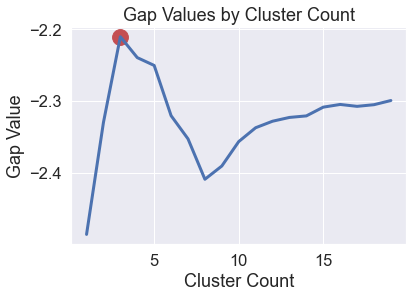

In [45]:
k, gapdf = optimalK(X_scaled_df, nrefs=5, maxClusters=20)
print('Optimal k is: ', k)

plt.plot(gapdf.clusterCount, gapdf.gap, linewidth=3)
plt.scatter(gapdf[gapdf.clusterCount == k].clusterCount, gapdf[gapdf.clusterCount == k].gap, s=250, c='r')
plt.grid(True)
plt.xlabel('Cluster Count')
plt.ylabel('Gap Value')
plt.title('Gap Values by Cluster Count')
plt.show()

In [46]:
gapdf

,clusterCount,gap
0,1.0,-2.485586
1,2.0,-2.329766
2,3.0,-2.210522
3,4.0,-2.239570
4,5.0,-2.250465
5,6.0,-2.320353
6,7.0,-2.352608
7,8.0,-2.408836
8,9.0,-2.390415
9,10.0,-2.356424


 ## Number of Clusters Using AIC and BIC from GMM

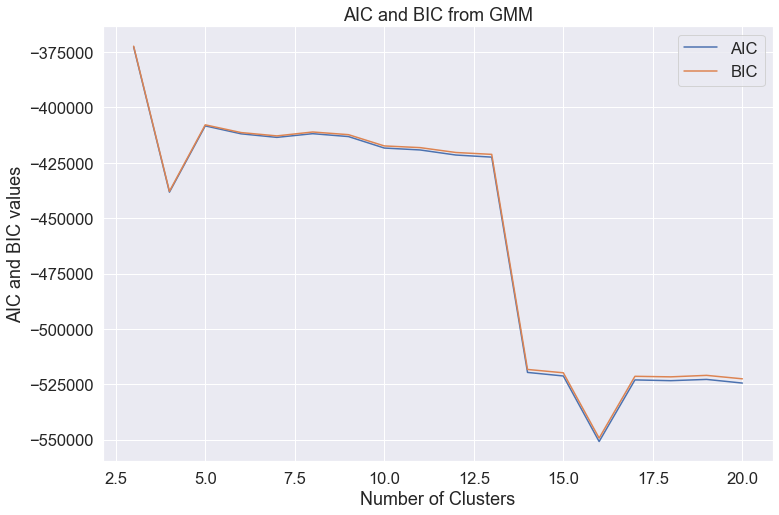

In [49]:
from sklearn.mixture import GaussianMixture
# Create empty dictionary for AIC and BIC values
aic_score = {} 
bic_score = {}

# Loop through different number of clusters
for i in range(3,21): 
  # Create Gaussian Mixture Model
  gmm = GaussianMixture(n_components=i, random_state=0).fit(X_scaled_df)
  # Get AIC score for the model
  aic_score[i] = gmm.aic(X_scaled_df)
  # Get BIC score for the model
  bic_score[i] = gmm.bic(X_scaled_df)
    
# Visualization
plt.figure(figsize=(12,8))
plt.plot(list(aic_score.keys()),list(aic_score.values()), label='AIC')
plt.plot(list(bic_score.keys()),list(bic_score.values()), label='BIC')
plt.legend(loc='best')
plt.title('AIC and BIC from GMM')
plt.xlabel('Number of Clusters')
plt.ylabel('AIC and BIC values')
plt.show()

In [52]:
aic = pd.DataFrame.from_dict(aic_score,orient ='index')
bic = pd.DataFrame.from_dict(bic_score,orient ='index')
aic

,0
3,-372604.700314
4,-438225.411767
5,-408313.628998
6,-411896.496179
7,-413499.854299
8,-411833.935931
9,-413136.081788
10,-418315.460076
11,-419181.038722
12,-421475.499451


In [53]:
bic

,0
3,-372324.778685
4,-437848.965438
5,-407840.657968
6,-411327.000450
7,-412833.833869
8,-411071.390802
9,-412277.011959
10,-417359.865547
11,-418128.919492
12,-420326.855522


In [57]:
print(aic.min())
print(bic.min())

0   -550842.975126
dtype: float64
0   -549308.232397
dtype: float64


### Inverse scaling

In [58]:
X_scaled_df

,Recency,Frequency,Monetary
0,-0.333986,-0.571299,-0.396089
1,-1.030698,-0.571299,-1.684829
2,0.428228,-0.571299,-0.775291
3,0.451973,-0.571299,-0.321162
4,-1.891066,1.378636,1.295904
...,...,...,...
114970,0.016199,-0.571299,0.218767
114971,-0.515444,-0.571299,0.241323
114972,0.004236,-0.571299,0.794027
114973,-2.190472,-0.571299,0.809631


In [59]:
features = ['Recency','Frequency','Monetary']

rfm_inverse_transform = scaler.inverse_transform(X_scaled_df)
rfm_inverse_transform = pd.DataFrame(np.exp(rfm_inverse_transform),columns=features)
rfm_inverse_transform

,Recency,Frequency,Monetary
0,125.0,1.0,99.33
1,64.0,1.0,24.39
2,260.0,1.0,65.71
3,266.0,1.0,107.78
4,28.0,3.0,627.74
...,...,...,...
114970,175.0,1.0,194.11
114971,105.0,1.0,198.94
114972,173.0,1.0,363.31
114973,21.0,1.0,369.54


In [60]:
rfm_inverse_transform.describe()

,Recency,Frequency,Monetary
count,114975.000000,114975.000000,114975.000000
mean,237.317286,1.777491,375.272364
std,152.473663,2.771765,1665.543011
min,1.000000,1.000000,9.590000
25%,113.000000,1.000000,70.050000
50%,218.000000,1.000000,133.530000
75%,345.000000,2.000000,276.960000
max,694.000000,75.000000,109312.640000


In [61]:
df_user.describe()

,Recency,Frequency,Monetary
count,115018.000000,115018.000000,115018.000000
mean,237.228564,1.777670,375.328291
std,152.514177,2.771438,1665.299621
min,0.000000,1.000000,9.590000
25%,113.000000,1.000000,70.040000
50%,218.000000,1.000000,133.530000
75%,345.000000,2.000000,276.960000
max,694.000000,75.000000,109312.640000


In [62]:
df_user

,customer_unique_id,Recency,Frequency,Monetary
0,708ab75d2a007f0564aedd11139c7708,125,1,99.33
1,a8b9d3a27068454b1c98cc67d4e31e6f,64,1,24.39
2,6f70c0b2f7552832ba46eb57b1c5651e,260,1,65.71
3,87695ed086ebd36f20404c82d20fca87,266,1,107.78
4,4291db0da71914754618cd789aebcd56,28,3,627.74
...,...,...,...,...
115013,18f40b803060d9883643b7e64e91628e,175,1,194.11
115014,13f283df2f4760f22b57830865761d07,105,1,198.94
115015,b6027ac07fb76ebca8c97b1887865aee,173,1,363.31
115016,b84dc68f02f122a88d7e7bbd37b06204,21,1,369.54


### Now we have identified the number of clusters we want, i.e either 5. Next step is to calaculate cluster centriods using genetic algorithm on the scaled rfm dataset (X_scaled_df).

1. First we will calculate the euclidean distance between the data points

In [65]:
k = 5

In [63]:
# Objective function
def kmeans(solution, solutionIndex):
    # Global vars
    global X_scaled_df, k
    
    # Centroids
    centroids = np.array(solution).reshape(k, len(solution) // k)
    # Finding the distance between centroids and all data points
    distances = cdist(X_scaled_df, centroids, 'euclidean')
    # Centroid with the minimum Distance
    points = np.array([np.argmin(i) for i in distances])
    
    # Calculate the sum square error
    error = []
    for idx in np.unique(points):
        temp_cent = X_scaled_df[points == idx]
        distances = cdist(temp_cent, centroids[idx].reshape(1, -1), 'euclidean')
        error.append(distances.sum())
    # Return result
    return np.sum(error)

In [64]:
# Fitness function
def fitnessFunction(solution, solutionIndex):
    outputExpected = kmeans(solution, solutionIndex)
    fitnessValue = 1.0 / (outputExpected + 0.00000001)
    return fitnessValue

## Change no. of parents mating to 10

#### Parameter for generation settings in Genetic Algorithm

* `num_generations` — number of generations in the Genetic algorithm
* `num_parents_mating` — number of chromosomes as parents in each generation
* `sol_per_pop` —number of chromosomes in each generation

#### Parameter for fitness function settings in Genetic Algorithm

* `fitness_func` — fitness function to be optimized by Genetic Algorithm
#### Parameter for genes settings in Genetic Algorithm

* `num_genes` — the number of genes in a chromosome
* `gene_type` — value type in genes
#### Parameter for values settings in Genetic Algorithm

* `init_range_low` — minimum value in genes
* `init_range_high` — maximum value in genes

#### Parameter for selection settings in Genetic Algorithm

* `parent_selection_type` — selection method implemented in Genetic Algorithm
* `keep_parents` — number of parent’s chromosomes kept in cross over each generation
#### Parameter for cross-over settings in Genetic Algorithm

* `crossover_type` — cross-over method implemented in Genetic Algorithm
* `crossover_probability` — cross over rate (Pc)
#### Parameter for mutation settings in Genetic Algorithm

* `mutation_type` — mutation method implemented in Genetic Algorithm
* `mutation_by_replacement` — boolean parameter. It determines whether the randomization in mutation performs the replacement or not
* `random_mutation_min_val` — minimum value for randomization in mutation
* `random_mutation_max_val` — maximum value for randomization in mutation
* `mutation_percent_genes` — mutation rate (Pm)
#### General parameters in Genetic Algorithm

* `save_solutions` — boolean parameter. It determines whether the Genetic Algorithm will save the solution in each generation or not
* `save_best_solutions` — a boolean parameter. It determines whether the Genetic Algorithm will save the best solution in each generation or not
* `suppress_warnings` — a boolean parameter. It determines whether the warning is printed out or not

In [68]:
# Prepare the parameters
# Generation
numberGeneration = 1000        # Number of generation
numberParentsMating = 10
solutionPerPopulation = 50     # Chromosomes in each generation
parents = -1
# Genes
numberGenes = k * X_scaled_df.shape[1]   # Number of genes in each chromosome
geneType = float               # Data type in each gene
# Range of values
minValue = -4                   # Minimum value of solution
maxValue = 4                   # Maximum value of solution
# Selection
selectionType = 'sss'          # Steady state selection
# Cross over
crossoverType = 'single_point' # Cross over with single point method
crossoverRate = 0.25           # Cross over rate (Pc)
# Mutation
mutationType = 'random'        # Mutation using random method
mutationReplacement = True     # Replace gene with random value
mutationMin = 0
mutationMax = 4
mutationRate = 10              # Mutation rate (Pm)

In [69]:
import pygad
from scipy.spatial.distance import cdist


# Set the parameters into Genetic Algorithm function
geneticAlgorithm = pygad.GA(
    # Number of generation
    num_generations = numberGeneration,
    
    # Number of parents mating
    num_parents_mating = numberParentsMating,
    
    # Number of gene each chromosome
    num_genes = numberGenes,
    
    # Gene type
    gene_type = geneType,
    
    # Fitness function
    fitness_func = fitnessFunction,
    
    # Number solution per population
    sol_per_pop = solutionPerPopulation,
    
    # Min and max value
    init_range_low = minValue,
    init_range_high = maxValue,
    
    # Selection
    parent_selection_type = selectionType,
    keep_parents = parents,
    
    # Cross over
    crossover_type = crossoverType,
    crossover_probability = crossoverRate,
    
    # Mutation
    mutation_type = mutationType,
    mutation_by_replacement = mutationReplacement,
    random_mutation_min_val = mutationMin,
    random_mutation_max_val = mutationMax,
    mutation_percent_genes = mutationRate,
    
    # Solutions
    save_solutions = True,
    save_best_solutions = True,
    suppress_warnings = True
)

In [70]:
# Run the Genetic Algorithm
geneticAlgorithm.run()

In [74]:
# Solution
solution, solutionFitness, solutionIndex = geneticAlgorithm.best_solution()
# Best solution
print('Parameters of the best solution: \n{solution}'.format(
    solution = solution.reshape(k, len(solution) // k)
    )
)
# Fitness value for best solution
print('Fitness value of the best solution: {solutionFit}'.format(
    solutionFit = solutionFitness
    )
)
# Index for best solution
# print('Index of the best solution: {solutionIndex}'.format(
#     solutionIndex = solutionIndex
#     )
# )

print("Best solution found after {gen} generations".format(gen=geneticAlgorithm.best_solution_generation))

Parameters of the best solution: 
[[ 4.68608084e-01  7.74929106e-01  7.68805348e-02]
 [ 3.67981456e-01  1.03562432e-02  8.68486814e-01]
 [-1.57071136e+00  6.66681687e-03  1.99193395e-03]
 [ 4.18143665e-01 -8.16621082e-01 -5.81505960e-01]
 [ 1.57452295e-01  2.00646710e+00  1.74739800e+00]]
Fitness value of the best solution: 9.543185712085163e-06
Best solution found after 947 generations


In [76]:
# Final centroids
centroids = solution.reshape(k, len(solution) // k)
# Finding the distance between centroids and all data points
distances = cdist(X_scaled_df, centroids, 'euclidean')
# Centroid with the minimum Distance
points = np.array([np.argmin(i) for i in distances])

In [93]:
# Global Optimal Centroids
centroids_df = pd.DataFrame(centroids,columns = ['X','Y','Z'])
centroids_df

,X,Y,Z
0,0.468608,0.774929,0.076881
1,0.367981,0.010356,0.868487
2,-1.570711,0.006667,0.001992
3,0.418144,-0.816621,-0.581506
4,0.157452,2.006467,1.747398


In [95]:
centroids_df.to_csv('centroids_df.csv',index=False)

In [77]:
# Centroids in array
solution.reshape(k, len(solution) // k)                 #(5,15//5)

array([[ 4.68608084e-01,  7.74929106e-01,  7.68805348e-02],
       [ 3.67981456e-01,  1.03562432e-02,  8.68486814e-01],
       [-1.57071136e+00,  6.66681687e-03,  1.99193395e-03],
       [ 4.18143665e-01, -8.16621082e-01, -5.81505960e-01],
       [ 1.57452295e-01,  2.00646710e+00,  1.74739800e+00]])

In [78]:
Cluster_number = pd.DataFrame(points,columns=['Clusters'])
Cluster_number.value_counts()

Clusters
3           52621
2           19518
1           17430
0           14337
4           11069
dtype: int64

In [79]:
result_df1 = pd.concat([X_scaled_df,Cluster_number],axis=1)
result_df1

,Recency,Frequency,Monetary,Clusters
0,-0.333986,-0.571299,-0.396089,3
1,-1.030698,-0.571299,-1.684829,3
2,0.428228,-0.571299,-0.775291,3
3,0.451973,-0.571299,-0.321162,3
4,-1.891066,1.378636,1.295904,2
...,...,...,...,...
114970,0.016199,-0.571299,0.218767,3
114971,-0.515444,-0.571299,0.241323,2
114972,0.004236,-0.571299,0.794027,1
114973,-2.190472,-0.571299,0.809631,2


In [80]:
rfm_inverse_transform

,Recency,Frequency,Monetary
0,125.0,1.0,99.33
1,64.0,1.0,24.39
2,260.0,1.0,65.71
3,266.0,1.0,107.78
4,28.0,3.0,627.74
...,...,...,...
114970,175.0,1.0,194.11
114971,105.0,1.0,198.94
114972,173.0,1.0,363.31
114973,21.0,1.0,369.54


In [81]:
rfm_inverse_transform['Clusters'] = result_df1['Clusters']
rfm_inverse_transform

,Recency,Frequency,Monetary,Clusters
0,125.0,1.0,99.33,3
1,64.0,1.0,24.39,3
2,260.0,1.0,65.71,3
3,266.0,1.0,107.78,3
4,28.0,3.0,627.74,2
...,...,...,...,...
114970,175.0,1.0,194.11,3
114971,105.0,1.0,198.94,2
114972,173.0,1.0,363.31,1
114973,21.0,1.0,369.54,2


In [87]:
rfm_inverse_transform.to_csv('rfm_inverse_transform_new.csv',index = False)
X_scaled_df.to_csv('X_scaled_df_new.csv',index = False)
rfm_log.to_csv('rfm_log_new.csv',index = False)

## Visualisation of clusters

In [88]:
# input matrix for segmentation
x = result_df1[['Recency','Frequency','Monetary']].values
x

array([[-0.33398565, -0.57129895, -0.39608904],
       [-1.03069765, -0.57129895, -1.68482942],
       [ 0.42822847, -0.57129895, -0.77529059],
       ...,
       [ 0.00423604, -0.57129895,  0.79402727],
       [-2.19047189, -0.57129895,  0.80963095],
       [ 0.45587818, -0.57129895,  0.20672705]])

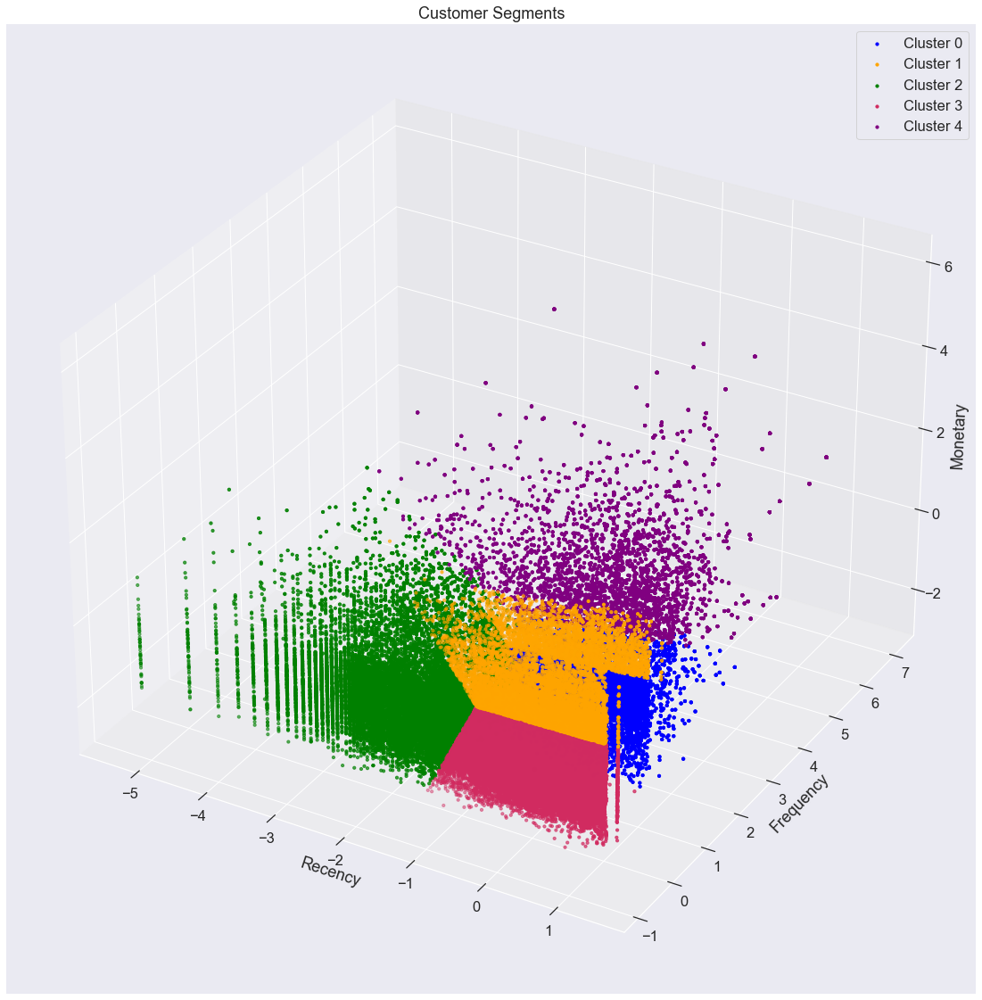

In [99]:
fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(111, projection='3d')

xs = result_df1.Recency
ys = result_df1.Frequency
zs = result_df1.Monetary

for cluster_idx in range(5):
    cluster_x = centroids_df.values[cluster_idx][0]
    cluster_y = centroids_df.values[cluster_idx][1]
    cluster_z = centroids_df.values[cluster_idx][2]
    ax.scatter(cluster_x, cluster_y,cluster_z,s=20,color='black')

ax.scatter(x[points == 0,0],x[points == 0,1],x[points == 0,2], s=10, color = 'blue', label = "Cluster 0")
ax.scatter(x[points == 1,0],x[points == 1,1],x[points == 1,2], s=10, color = 'orange', label = "Cluster 1")
ax.scatter(x[points == 2,0],x[points == 2,1],x[points == 2,2], s=10, color = 'green', label = "Cluster 2")
ax.scatter(x[points == 3,0],x[points == 3,1],x[points == 3,2], s=10, color = '#D12B60', label = "Cluster 3")
ax.scatter(x[points == 4,0],x[points == 4,1],x[points == 4,2], s=10, color = 'purple', label = "Cluster 4")

ax.set_xlabel('Recency')
ax.set_ylabel('Frequency')
ax.set_zlabel('Monetary')
ax.set_title('Customer Segments')

ax.legend()

plt.show()

In [104]:
# 3d scatterplot using plotly
Scene = dict(xaxis = dict(title  = 'Recency'),yaxis = dict(title  = 'Frequency'),zaxis = dict(title  = 'Monetary'))
# layout_cent = go.Layout(margin=dict(l=0,r=0),scene = Scene,height = 800,width = 800)


# for cluster_idx in range(5):
#     cluster_x = centroids_df.values[cluster_idx][0]
#     cluster_y = centroids_df.values[cluster_idx][1]
#     cluster_z = centroids_df.values[cluster_idx][2]
#     trace_centroid = go.Scatter3d(cluster_x, cluster_y,cluster_z,s=20,color='black',mode='markers',marker=dict(line=dict(color= 'black',width = 20)))
#     data_cent = trace_centroid
#     fig = go.Figure(data = data_cent, layout = layout_cent)
    
    
# model.labels_ is nothing but the predicted clusters i.e y_clusters
labels = points
trace1 = go.Scatter3d(x=x[points == 0,0], y=x[points == 0,1], z=x[points == 0,2],name='Cluster 0',mode='markers',marker=dict(line=dict(color= 'black',width = 1)))
trace2 = go.Scatter3d(x=x[points == 1,0], y=x[points == 1,1], z=x[points == 1,2],name='Cluster 1', mode='markers',marker=dict(line=dict(color= 'black',width = 1)))
trace3 = go.Scatter3d(x=x[points == 2,0], y=x[points == 2,1], z=x[points == 2,2],name='Cluster 2', mode='markers',marker=dict(line=dict(color= 'black',width = 1)))
trace4 = go.Scatter3d(x=x[points == 3,0], y=x[points == 3,1], z=x[points == 3,2],name='Cluster 3', mode='markers',marker=dict(line=dict(color= 'black',width = 1)))
trace5 = go.Scatter3d(x=x[points == 4,0], y=x[points == 4,1], z=x[points == 4,2],name='Cluster 4', mode='markers',marker=dict(line=dict(color= 'black',width = 1)))



layout = go.Layout(title = "Customer Segments",margin=dict(l=0,r=0),scene = Scene,height = 800,width = 800)

data = [trace1,trace2,trace3,trace4,trace5]

fig = go.Figure(data = data, layout = layout)

# fig.update_layout(showlegend=True)
fig.show()

# trace = go.Scatter3d( mode='markers',marker=dict(line=dict(color= 'black',width = 10)))

# xpoints = np.arange(0, math.pi*2, 0.05)
# y1 = np.sin(xpoints)
# y2 = np.cos(xpoints)

# trace0 = go.Scatter(x = xpoints,y = y1,name='Sine')
# trace1 = go.Scatter(x = xpoints,y = y2,name = 'cos')
# data = [trace0, trace1]
# layout = go.Layout(title = "Sine and cos", xaxis = {'title':'angle'}, yaxis = {'title':'value'})
# fig = go.Figure(data = data, layout = layout)
# iplot(fig)